In [1]:
import pandas as pd
import numpy as np
import xarray as xr
import time 
import tqdm
import glob
import yaml
import os

from sklearn.preprocessing import StandardScaler
import multiprocessing as mp

from mlguess.pit import pit_deviation_skill_score, pit_deviation
from mlguess.keras.models import EvidentialRegressorDNN


from mlguess.keras.callbacks import get_callbacks
from mlguess.regression_uq import compute_results
#from mlguess.regression_uq import Test1AB
import tensorflow as tf
import random

2024-10-16 22:47:53.538630: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-16 22:47:53.582895: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-16 22:47:53.582932: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-16 22:47:53.584267: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-16 22:47:53.592479: I tensorflow/core/platform/cpu_feature_guar

In [2]:
print(tf.config.list_physical_devices('GPU'))

[]


2024-10-16 22:48:00.619339: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:274] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected


In [3]:
"source ~/.bashrc","module unload cuda cudnn","conda activate guess-gpu3",'CUDNN_PATH=$(dirname $(python -c "import nvidia.cudnn;print(nvidia.cudnn.__file__)"))','export LD_LIBRARY_PATH=$LD_LIBRARY_PATH:$CONDA_PREFIX/lib/:$CUDNN_PATH/lib','export XLA_FLAGS=--xla_gpu_cuda_data_dir=$CONDA_PREFIX'

('source ~/.bashrc',
 'module unload cuda cudnn',
 'conda activate guess-gpu3',
 'CUDNN_PATH=$(dirname $(python -c "import nvidia.cudnn;print(nvidia.cudnn.__file__)"))',
 'export LD_LIBRARY_PATH=$LD_LIBRARY_PATH:$CONDA_PREFIX/lib/:$CUDNN_PATH/lib',
 'export XLA_FLAGS=--xla_gpu_cuda_data_dir=$CONDA_PREFIX')

In [4]:
config = '/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/evidential_with_echo_output/config/best_re_echo_trial_194_PR11.yml'

In [5]:
with open(config) as cf:
    conf = yaml.load(cf, Loader=yaml.FullLoader)

In [6]:
conf['model']

{'activation': 'relu',
 'batch_size': 12415,
 'dropout_alpha': 0.152712630043728,
 'epochs': 2000,
 'evidential_coef': 0.5880854988378059,
 'hidden_layers': 1,
 'hidden_neurons': 823,
 'kernel_reg': 'l2',
 'l1_weight': 5.13946696844333e-11,
 'l2_weight': 5.1109726042924564e-08,
 'loss': 'evidentialReg',
 'lr': 1.6914868229211361e-06,
 'metrics': 'mae',
 'optimizer': 'adam',
 'use_dropout': True,
 'use_noise': False,
 'verbose': 2}

In [7]:
#met_vars are 11 feature variables, output_vars is my single target variable
met_vars = conf["met_vars"]
output_vars = conf["output_vars"]
seed = conf["seed"]
print(seed)

0


In [8]:
# this is a list
output_vars

['WG_o(m/s)']

In [9]:
met_vars

['WS_950mb(m/s)',
 'WS_850mb(m/s)',
 'WS_10m(m/s)',
 'PBLH(km)',
 'Ustar(m/s)',
 'Temp_grad(1km_sfc)(C/km)',
 'Temp_grad(2km_sfc)(C/km)',
 'Terrain_height(m)',
 'WindDC(cos)',
 'WindDC(sin)',
 'yday']

In [10]:
scaler_x = StandardScaler()
scaler_y = StandardScaler()

In [11]:
train_data_path= '/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Data/train_data.csv'
valid_data_path= '/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Data/valid_data.csv'

In [12]:
# Gridded test data
test_data_path= '/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Data/Processed_test_grid/Processed_WRF422_2020040912.csv'

In [13]:
train_data= pd.read_csv(train_data_path)
valid_data= pd.read_csv(valid_data_path)
test_data= pd.read_csv(test_data_path)

In [14]:
def seed_everything(seed):
    """Set seeds for reproducibility"""
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)
    tf.keras.utils.set_random_seed(seed)
    tf.config.experimental.enable_op_determinism()

In [15]:
x_train = scaler_x.fit_transform(train_data[met_vars])
x_valid = scaler_x.transform(valid_data[met_vars])
x_test = scaler_x.transform(test_data[met_vars])

y_train = scaler_y.fit_transform(train_data[output_vars])
y_valid = scaler_y.transform(valid_data[output_vars])
#y_test = scaler_y.transform(test_data[output_vars])

In [16]:
# Fix seed for reproducibility
seed_everything(seed)

In [ ]:
#Load the model
model = EvidentialRegressorDNN(**conf["model"])
model.build_neural_network(x_train.shape[-1], y_train.shape[-1])
model.fit(x_train,y_train,
          validation_data=(x_valid,y_valid),
          callbacks=get_callbacks(conf))
history = model.model.history

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 11)]              0         
                                                                 
 dense_00 (Dense)            (None, 823)               9876      
                                                                 
 dropout_h_00 (Dropout)      (None, 823)               0         
                                                                 
 DenseNormalGamma (DenseNor  (None, 4)                 3300      
 malGamma)                                                       
                                                                 
Total params: 13176 (51.47 KB)
Trainable params: 13172 (51.45 KB)
Non-trainable params: 4 (16.00 Byte)
_________________________________________________________________
Epoch 1/2000
11/11 - 6s - loss: 2.9542 - mae: 0.8070 - val_loss: 3.5063 - val_mae: 1.0164 

/glade/work/ijahan/miniconda3/envs/guess-gpu3/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


11/11 - 1s - loss: 2.9498 - mae: 0.8060 - val_loss: 3.5023 - val_mae: 1.0153 - lr: 1.6915e-06 - 1s/epoch - 136ms/step
Epoch 3/2000
11/11 - 2s - loss: 2.9452 - mae: 0.8047 - val_loss: 3.4990 - val_mae: 1.0144 - lr: 1.6915e-06 - 2s/epoch - 143ms/step
Epoch 4/2000
11/11 - 2s - loss: 2.9421 - mae: 0.8040 - val_loss: 3.4959 - val_mae: 1.0138 - lr: 1.6915e-06 - 2s/epoch - 153ms/step
Epoch 5/2000
11/11 - 2s - loss: 2.9399 - mae: 0.8036 - val_loss: 3.4929 - val_mae: 1.0132 - lr: 1.6915e-06 - 2s/epoch - 138ms/step
Epoch 6/2000
11/11 - 1s - loss: 2.9368 - mae: 0.8028 - val_loss: 3.4899 - val_mae: 1.0126 - lr: 1.6915e-06 - 1s/epoch - 136ms/step
Epoch 7/2000
11/11 - 2s - loss: 2.9332 - mae: 0.8018 - val_loss: 3.4870 - val_mae: 1.0120 - lr: 1.6915e-06 - 2s/epoch - 158ms/step
Epoch 8/2000
11/11 - 2s - loss: 2.9313 - mae: 0.8015 - val_loss: 3.4840 - val_mae: 1.0114 - lr: 1.6915e-06 - 2s/epoch - 138ms/step
Epoch 9/2000
11/11 - 1s - loss: 2.9282 - mae: 0.8008 - val_loss: 3.4811 - val_mae: 1.0108 - lr: 

In [18]:
result = model.predict_uncertainty(x_test,scaler = scaler_y)
mu, aleatoric, epistemic = result
ale_sigma= np.sqrt(aleatoric)
epi_sigma= np.sqrt(epistemic)
total= np.sqrt(aleatoric+epistemic)

133/133 [==============================] - 0s 1ms/step


In [19]:
mu.shape

(1640960, 1)

In [20]:
mu.ravel()


array([ 9.158436,  9.244447,  9.357783, ..., 10.040627,  9.931078,
        9.830115], dtype=float32)

In [21]:
# Combine mean predictions with longitude, latitude, and time
Y_pred_df = pd.DataFrame({'Predictions': mu.ravel(), 
                          'Ale(sigma)':ale_sigma.ravel(), 
                          'Epi(sigma)':epi_sigma.ravel(),
                          'Total': total.ravel(),
                          'Lat': test_data['Lat'],
                          'Lon': test_data['Lon'], 
                          'YYYY': test_data['YYYY'],
                          'MM' : test_data['MM'],
                          'DD': test_data['DD'], 
                          'HH' : test_data['HH']})

In [22]:
def YYYYMMDDHH_string(Datetime_Value):
    if Datetime_Value.month>9:
        Month_str = str(Datetime_Value.month)
    else:
        Month_str = "0"+str(Datetime_Value.month)   
    if Datetime_Value.day>9:
        Day_str = str(Datetime_Value.day)
    else:
        Day_str = "0"+str(Datetime_Value.day)
    if Datetime_Value.hour>9:
        Hour_str = str(Datetime_Value.hour)
    else:
        Hour_str = "0"+str(Datetime_Value.hour)
    return (str(Datetime_Value.year)+Month_str+Day_str+Hour_str)

In [23]:
from datetime import datetime
from datetime import timedelta
import time

In [24]:
Time_Valid = np.empty((len(Y_pred_df), 1), dtype=object)
for x in range(len(Y_pred_df)):
    date = datetime(Y_pred_df["YYYY"][x],Y_pred_df["MM"][x],Y_pred_df["DD"][x],Y_pred_df["HH"][x],0,0)
    Time_Valid[x,0] = YYYYMMDDHH_string(date)

In [25]:
Y_pred_df['Time']=pd.DataFrame(Time_Valid)

In [26]:
Y_pred_df['Time'] = pd.to_datetime(Y_pred_df['Time'], format='%Y%m%d%H')

In [27]:
Y_pred_df['Time']

0         2020-04-09 12:00:00
1         2020-04-09 12:00:00
2         2020-04-09 12:00:00
3         2020-04-09 12:00:00
4         2020-04-09 12:00:00
                  ...        
1640955   2020-04-11 12:00:00
1640956   2020-04-11 12:00:00
1640957   2020-04-11 12:00:00
1640958   2020-04-11 12:00:00
1640959   2020-04-11 12:00:00
Name: Time, Length: 1640960, dtype: datetime64[ns]

In [28]:
Y_pred_df

,Predictions,Ale(sigma),Epi(sigma),Total,Lat,Lon,YYYY,MM,DD,HH,Time
0,9.158436,0.726960,1.462858,1.633531,39.61,-78.07,2020,4,9,12,2020-04-09 12:00:00
1,9.244447,0.743963,1.462606,1.640944,39.61,-78.02,2020,4,9,12,2020-04-09 12:00:00
2,9.357783,0.769017,1.467475,1.656765,39.61,-77.98,2020,4,9,12,2020-04-09 12:00:00
3,9.392804,0.776283,1.482231,1.673208,39.61,-77.93,2020,4,9,12,2020-04-09 12:00:00
4,9.480531,0.794769,1.489112,1.687932,39.61,-77.88,2020,4,9,12,2020-04-09 12:00:00
...,...,...,...,...,...,...,...,...,...,...,...
1640955,10.317231,0.880946,1.526388,1.762364,45.74,-68.86,2020,4,11,12,2020-04-11 12:00:00
1640956,10.154212,0.871740,1.482952,1.720197,45.73,-68.81,2020,4,11,12,2020-04-11 12:00:00
1640957,10.040627,0.860306,1.462073,1.696403,45.73,-68.76,2020,4,11,12,2020-04-11 12:00:00
1640958,9.931078,0.849200,1.438918,1.670816,45.72,-68.70,2020,4,11,12,2020-04-11 12:00:00


In [29]:
Y_pred_df.to_csv('Gridded_preds_2020_04_09_12.csv',index=False)

In [30]:
# Define the end time
end_time = pd.Timestamp(Y_pred_df.loc[len(Y_pred_df)-1,'Time'])

In [31]:
end_time

Timestamp('2020-04-11 12:00:00')

In [32]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
import matplotlib.colors as colors

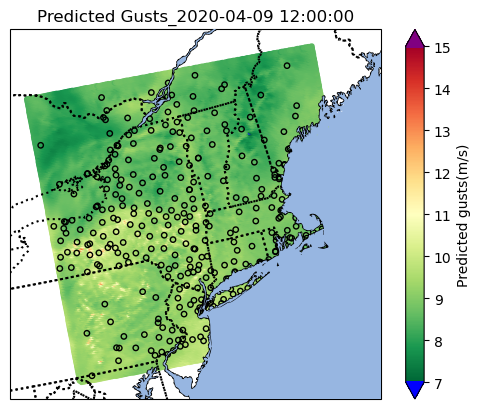

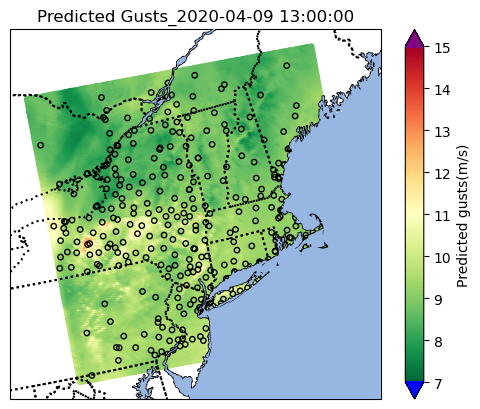

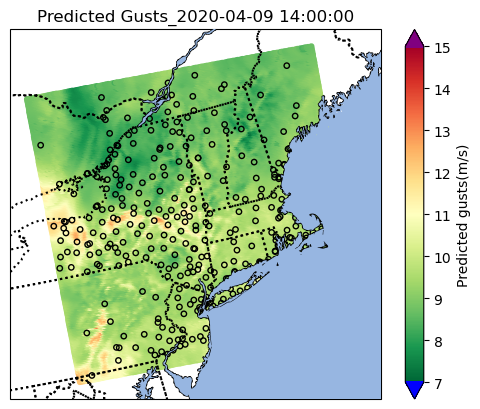

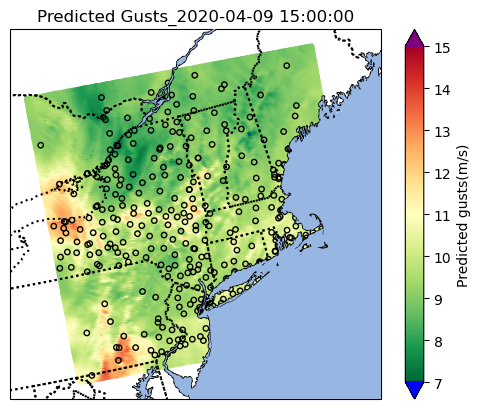

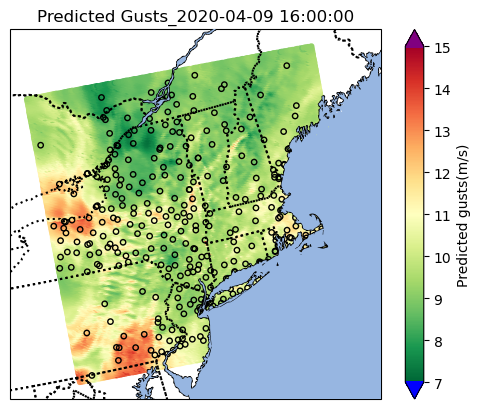

...

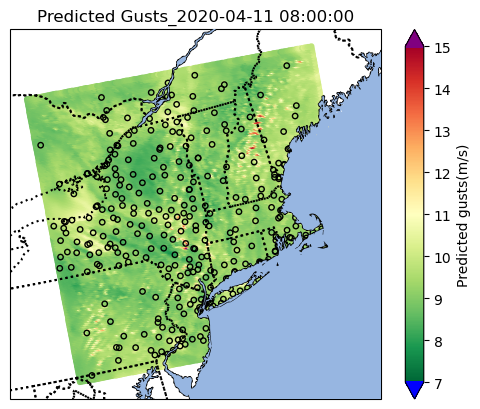

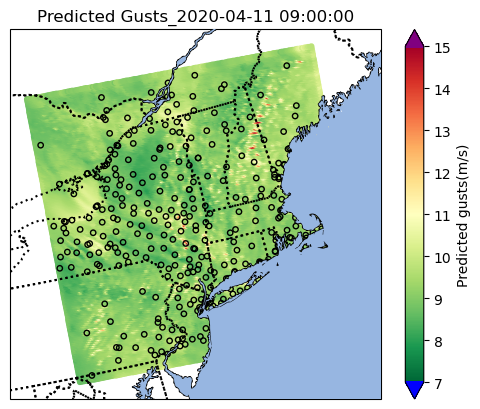

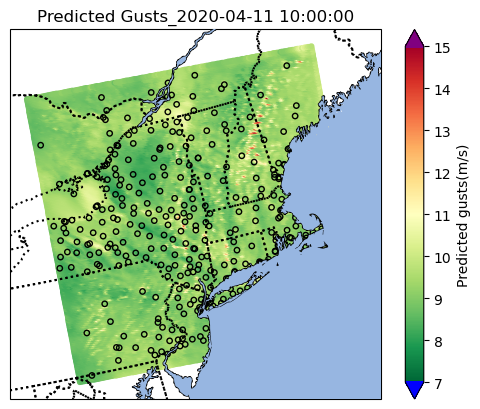

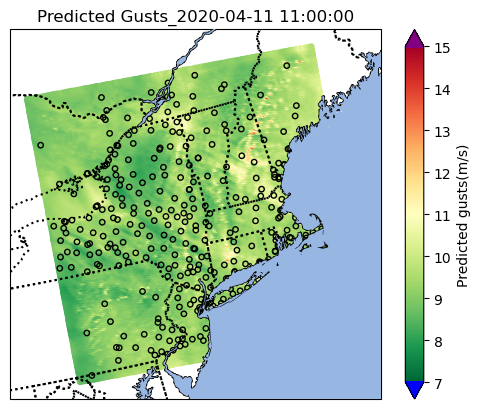

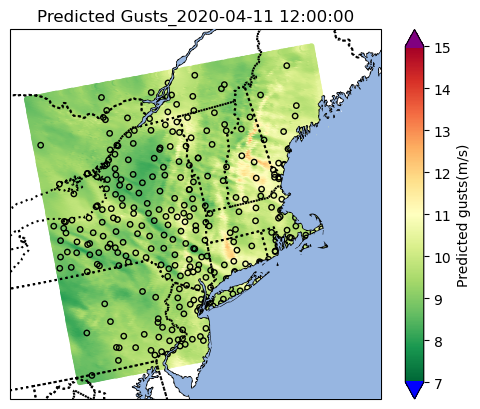

In [46]:
save_path='/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Spatial_plots/2020_04_09_12UTC/Preds_ocean_masked/'
# Loop over each hour until the end time is reached
for day in pd.date_range(start=Y_pred_df['Time'].iloc[0], end=end_time, freq='h'):  
    # Filter Y_pred_df to include only data from the current hour
    day_data = Y_pred_df[(Y_pred_df['Time'].dt.month == day.month) &  (Y_pred_df['Time'].dt.day == day.day) & (Y_pred_df['Time'].dt.hour == day.hour) ]
    # Plotting the data
    ax = plt.subplot(1, 1, 1, projection=ccrs.LambertConformal()) # I want the resultiong map to have Lambert Corformal Conic projection 
    # Create a custom colormap
    cmap = plt.cm.RdYlGn_r
    cmap_combined = colors.ListedColormap(['blue']+list(cmap(np.linspace(0, 1, 256))) + ['purple'])
    val_min = 7
    val_max = 15
    norm = colors.Normalize(vmin=val_min, vmax=val_max)
    # Add coastlines
    ax.coastlines(resolution='10m')
    
    ax.add_feature(cfeature.STATES, linestyle=':', edgecolor='black',linewidth=1.5)
    ax.add_feature(cfeature.OCEAN, zorder=12)  #zorder > 10
    
    # Since my data is deined on  lat-lon values,I need to use PlateCarree in the transform argument
    
    scatter=plt.scatter(day_data['Lon'], day_data['Lat'], c=day_data['Predictions'], cmap=cmap_combined,norm=norm,transform=ccrs.PlateCarree(), s=10)
    plt.scatter(stations["Lon"],stations["Lat"],s=15, edgecolor='black',facecolors='none',zorder=10,transform=ccrs.PlateCarree())
    
    #colorbar = plt.colorbar(scatter, label='Predicted gusts(m/s)')
    colorbar = plt.colorbar(scatter, label='Predicted gusts(m/s)',ticks=np.arange(val_min, val_max+2, 1), extend='both')

    # # Add colorbar
    # plt.colorbar(scatter, ax=ax, orientation='vertical', label='Predicted gusts(m/s)',
    #              boundaries=boundaries, ticks=boundaries, format='%g')  # Add a label for the colorbar
    
    # Add title and labels
    plt.title('Predicted Gusts_'+ str(day))
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.savefig(save_path+'Evidential_gridded_gust_preds_'+str(day)+'.png', dpi=600, bbox_inches= 'tight')
    plt.show()

In [ ]:
## Plot total uncertainty

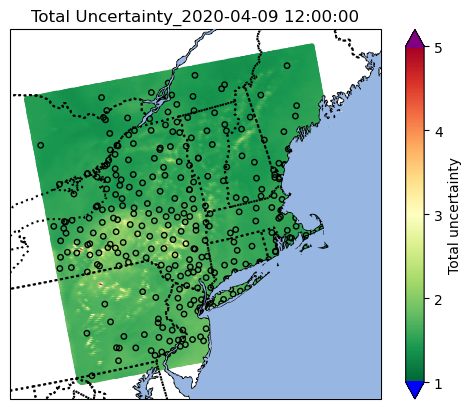

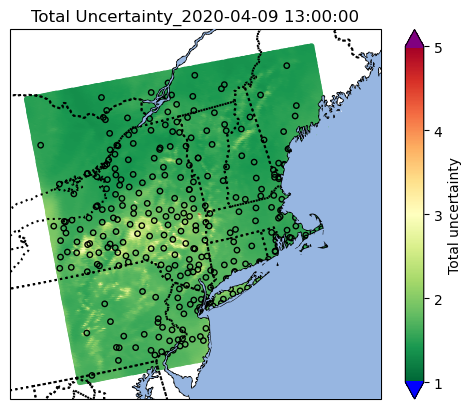

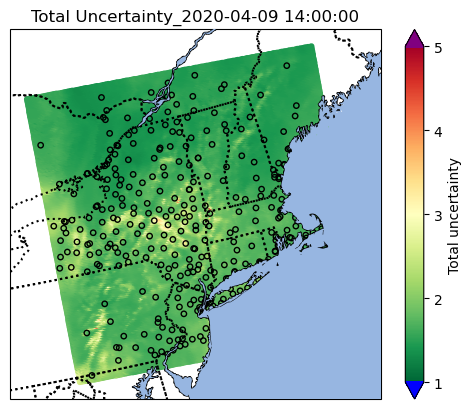

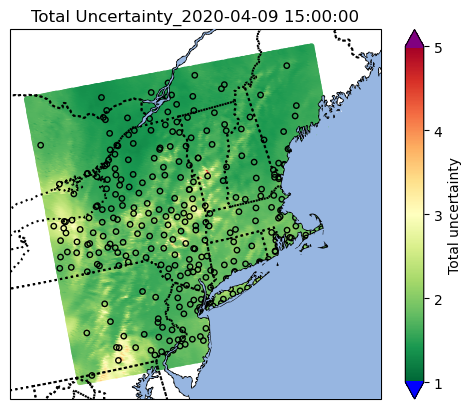

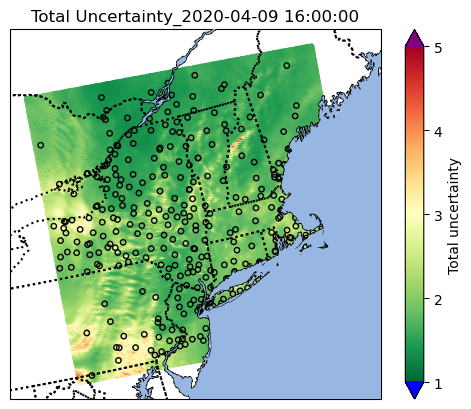

...

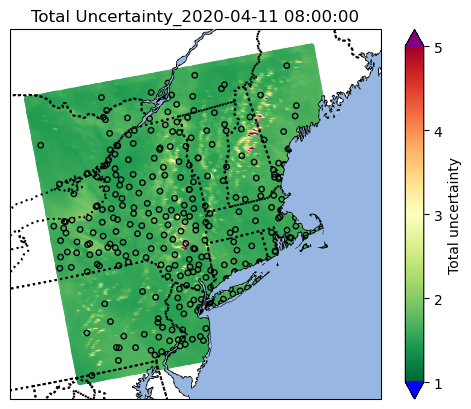

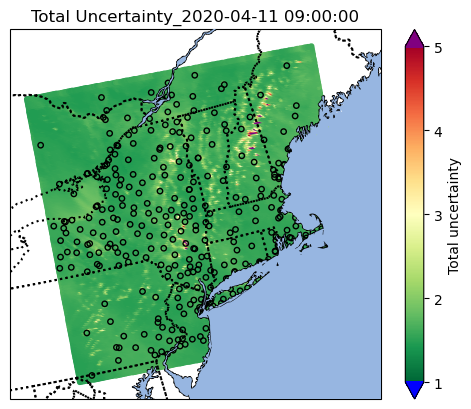

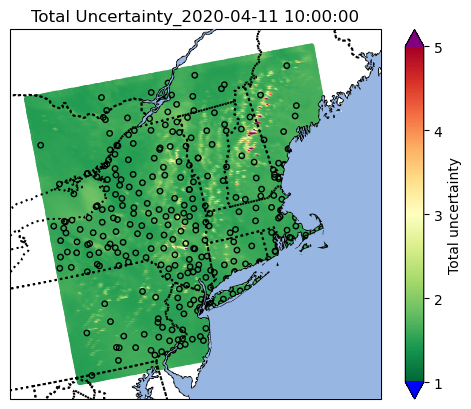

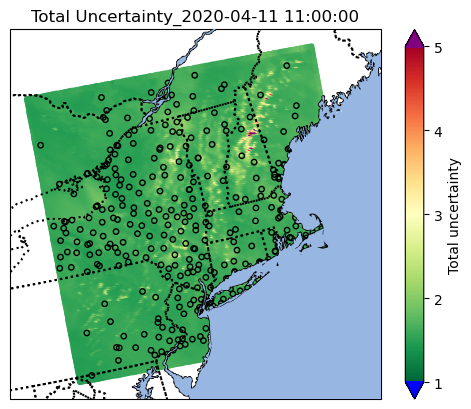

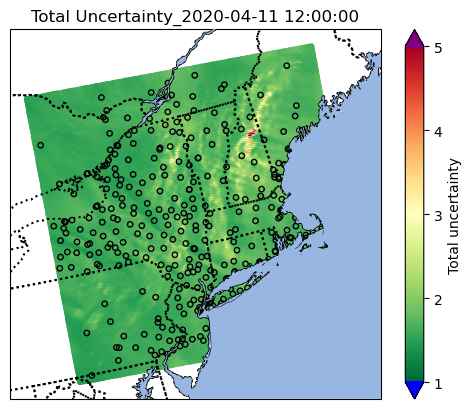

In [63]:
save_path='/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Spatial_plots/2020_04_09_12UTC/Total_ocean_masked/'
# Loop over each hour until the end time is reached
for day in pd.date_range(start=Y_pred_df['Time'].iloc[0], end=end_time, freq='h'):  
    # Filter Y_pred_df to include only data from the current hour
    day_data = Y_pred_df[(Y_pred_df['Time'].dt.month == day.month) &  (Y_pred_df['Time'].dt.day == day.day) & (Y_pred_df['Time'].dt.hour == day.hour) ]
    # Plotting the data
    ax = plt.subplot(1, 1, 1, projection=ccrs.LambertConformal()) # I want the resultiong map to have Lambert Corformal Conic projection 
    # Create a custom colormap
    cmap = plt.cm.RdYlGn_r
    cmap_combined = colors.ListedColormap(['blue']+list(cmap(np.linspace(0, 1, 256))) + ['purple'])
    val_min = 1
    val_max = 5
    norm = colors.Normalize(vmin=val_min, vmax=val_max)
    # Add coastlines
    ax.coastlines(resolution='10m')
    
    ax.add_feature(cfeature.STATES, linestyle=':', edgecolor='black',linewidth=1.5)
    ax.add_feature(cfeature.OCEAN, zorder=12)  #zorder > 10
    
    # Since my data is deined on  lat-lon values,I need to use PlateCarree in the transform argument
    
    scatter=plt.scatter(day_data['Lon'], day_data['Lat'], c=day_data['Total'], cmap=cmap_combined,norm=norm,transform=ccrs.PlateCarree(), s=10) 
    plt.scatter(stations["Lon"], stations["Lat"], s=15, edgecolor='black', facecolors='none',zorder=10, transform=ccrs.PlateCarree())
    #colorbar = plt.colorbar(scatter, label='Epistemic')
    colorbar = plt.colorbar(scatter, label='Total uncertainty',ticks=np.arange(val_min, val_max+1, 1), extend='both')

    # # Add colorbar
    # plt.colorbar(scatter, ax=ax, orientation='vertical', label='Predicted gusts(m/s)',
    #              boundaries=boundaries, ticks=boundaries, format='%g')  # Add a label for the colorbar
    
    # Add title and labels
    plt.title('Total Uncertainty_'+ str(day))
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.savefig(save_path+'Total_'+str(day)+'.png', dpi=600, bbox_inches= 'tight')
    plt.show()    

In [64]:
from scipy.interpolate import griddata
# Load CSV file with station latitude and longitude values
stations = pd.read_csv('/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Data/Stations_ISD_NYSM.csv')

In [65]:
# Initialize an empty dataframe to store the results
final_interpolated_df = pd.DataFrame() 

In [66]:
# Loop over each hour until the end time is reached
for day in pd.date_range(start=Y_pred_df['Time'].iloc[0], end=end_time, freq='h'):  
    # Filter Y_pred_df to include only data from the current hour
    day_data = Y_pred_df[(Y_pred_df['Time'].dt.month == day.month) &  (Y_pred_df['Time'].dt.day == day.day) & (Y_pred_df['Time'].dt.hour == day.hour) ]
    
    # Define the points which you want to interpolate
    points = day_data[['Lat', 'Lon']].values
    
    # Define the values corresponding to the points
    pred_values = day_data['Predictions'].values
    ale_values = day_data['Ale(sigma)'].values
    epi_values = day_data['Epi(sigma)'].values
    total_values = day_data['Total'].values
    
    # Define the grid where you want to interpolate (based on obs dataframe)
    grid_x = stations['Lat'].values
    grid_y = stations['Lon'].values
    
    # Perform the interpolation
    interpolated_pred = griddata(points, pred_values, (grid_x, grid_y), method='linear')
    interpolated_ale = griddata(points, ale_values, (grid_x, grid_y), method='linear')
    interpolated_epi = griddata(points, epi_values, (grid_x, grid_y), method='linear')
    interpolated_total = griddata(points, total_values, (grid_x, grid_y), method='linear')
    
    # Create a new dataframe with interpolated values, latitudes, longitudes, and corresponding Station_ID
    interpolated_df = pd.DataFrame({
        'Interpolated_Predictions': interpolated_pred,
        'Interpolated_Aleatoric(sigma)': interpolated_ale,
        'Interpolated_Epistemic(sigma)': interpolated_epi,
        'Interpolated_Total': interpolated_total,
        'Interpolated_Lat': grid_x,
        'Interpolated_Lon': grid_y,
        'Station_ID': stations['Station_ID'],
        'Time': day, # Add a new column with timestamp values 
        'YYYY': day.year,
        'MM': day.month,
        'DD':day.day,
        'HH':day.hour
    })
    # Append the current interpolated dataframe to the final result dataframe
    #final_interpolated_df = final_interpolated_df.append(interpolated_df, ignore_index=True)
    final_interpolated_df = pd.concat([final_interpolated_df,interpolated_df],ignore_index=True)

In [67]:
final_interpolated_df

,Interpolated_Predictions,Interpolated_Aleatoric(sigma),Interpolated_Epistemic(sigma),Interpolated_Total,Interpolated_Lat,Interpolated_Lon,Station_ID,Time,YYYY,MM,DD,HH
0,8.417634,0.660923,1.244703,1.409293,45.367000,-72.767000,71036799999,2020-04-09 12:00:00,2020,4,9,12
1,8.062017,0.591630,1.241802,1.375541,45.383333,-75.716667,71063099999,2020-04-09 12:00:00,2020,4,9,12
2,8.373170,0.609439,1.334433,1.467077,44.633333,-75.733333,71161099999,2020-04-09 12:00:00,2020,4,9,12
3,8.867934,0.688337,1.330678,1.498170,45.466667,-73.733333,71183099999,2020-04-09 12:00:00,2020,4,9,12
4,8.470870,0.633366,1.386943,1.524803,44.416667,-75.850000,71281099999,2020-04-09 12:00:00,2020,4,9,12
...,...,...,...,...,...,...,...,...,...,...,...,...
16067,9.157544,0.746326,1.399706,1.586491,43.874690,-73.418790,TICO,2020-04-11 12:00:00,2020,4,11,12
16068,10.208039,0.821152,1.580942,1.781520,44.313604,-73.371896,ESSX,2020-04-11 12:00:00,2020,4,11,12
16069,9.622568,0.847808,1.513999,1.735479,42.526200,-73.359060,STEP,2020-04-11 12:00:00,2020,4,11,12
16070,9.902892,0.792289,1.557124,1.747126,40.919120,-73.131680,STON,2020-04-11 12:00:00,2020,4,11,12


In [68]:
final_interpolated_df.to_csv('Interpolated_hourwise_2020040912.csv',index=False)

In [69]:
final_interpolated_df['Interpolated_Predictions'].min()

7.060311741685867

In [70]:
final_interpolated_df['Interpolated_Predictions'].max()

16.641714336872433

In [71]:
final_interpolated_df['Interpolated_Aleatoric(sigma)'].min()

0.5291909362053278

In [72]:
final_interpolated_df['Interpolated_Aleatoric(sigma)'].max()

1.0530892779350263

In [73]:
final_interpolated_df['Interpolated_Epistemic(sigma)'].min()

1.1735303942084334

In [74]:
final_interpolated_df['Interpolated_Epistemic(sigma)'].max()

10.618427620325049

In [75]:
final_interpolated_df['Interpolated_Total'].min()

1.3118445910096177

In [76]:
final_interpolated_df['Interpolated_Total'].max()

10.67913440833088

### Following blocks of code were written to get alatoric and epistemic variances
### and to get the UQ plots

In [77]:
result_new = model.predict_uncertainty(x_test,scaler = scaler_y)

133/133 [==============================] - 0s 1ms/step


In [78]:
mu, aleatoric_var, epistemic_var = result_new

In [79]:
# Combine mean predictions with longitude, latitude, and time
Y_pred_df_new = pd.DataFrame({'Predictions': mu.ravel(), 
                          'Ale(var)':aleatoric_var.ravel(), 
                          'Epi(var)':epistemic_var.ravel(),
                          'Lat': test_data['Lat'],
                          'Lon': test_data['Lon'], 
                          'YYYY': test_data['YYYY'],
                          'MM' : test_data['MM'],
                          'DD': test_data['DD'], 
                          'HH' : test_data['HH']})

In [80]:
Time_Valid = np.empty((len(Y_pred_df_new), 1), dtype=object)
for x in range(len(Y_pred_df_new)):
    date = datetime(Y_pred_df_new["YYYY"][x],Y_pred_df_new["MM"][x],Y_pred_df_new["DD"][x],Y_pred_df_new["HH"][x],0,0)
    Time_Valid[x,0] = YYYYMMDDHH_string(date)

In [81]:
Y_pred_df_new['Time']=pd.DataFrame(Time_Valid)

In [82]:
Y_pred_df_new['Time'] = pd.to_datetime(Y_pred_df_new['Time'], format='%Y%m%d%H')

In [83]:
Y_pred_df_new

,Predictions,Ale(var),Epi(var),Lat,Lon,YYYY,MM,DD,HH,Time
0,9.158436,0.528471,2.139953,39.61,-78.07,2020,4,9,12,2020-04-09 12:00:00
1,9.244447,0.553481,2.139217,39.61,-78.02,2020,4,9,12,2020-04-09 12:00:00
2,9.357783,0.591387,2.153482,39.61,-77.98,2020,4,9,12,2020-04-09 12:00:00
3,9.392804,0.602616,2.197010,39.61,-77.93,2020,4,9,12,2020-04-09 12:00:00
4,9.480531,0.631658,2.217455,39.61,-77.88,2020,4,9,12,2020-04-09 12:00:00
...,...,...,...,...,...,...,...,...,...,...
1640955,10.317231,0.776066,2.329860,45.74,-68.86,2020,4,11,12,2020-04-11 12:00:00
1640956,10.154212,0.759931,2.199147,45.73,-68.81,2020,4,11,12,2020-04-11 12:00:00
1640957,10.040627,0.740127,2.137657,45.73,-68.76,2020,4,11,12,2020-04-11 12:00:00
1640958,9.931078,0.721142,2.070484,45.72,-68.70,2020,4,11,12,2020-04-11 12:00:00


In [84]:
# Initialize an empty dataframe to store the results
final_interpolated_df_new = pd.DataFrame() 

In [ ]:
## interpolate gridded output(pred and variances) to station locations

In [85]:
# Loop over each hour until the end time is reached
for day in pd.date_range(start=Y_pred_df_new['Time'].iloc[0], end=end_time, freq='h'):  
    # Filter Y_pred_df to include only data from the current hour
    day_data = Y_pred_df_new[(Y_pred_df_new['Time'].dt.month == day.month) &  (Y_pred_df_new['Time'].dt.day == day.day) & (Y_pred_df_new['Time'].dt.hour == day.hour) ]
    
    # Define the points which you want to interpolate
    points = day_data[['Lat', 'Lon']].values
    
    # Define the values corresponding to the points
    pred_values = day_data['Predictions'].values
    ale_values = day_data['Ale(var)'].values
    epi_values = day_data['Epi(var)'].values
    #total_values = day_data['Total'].values
    
    # Define the grid where you want to interpolate (based on obs dataframe)
    grid_x = stations['Lat'].values
    grid_y = stations['Lon'].values
    
    # Perform the interpolation
    interpolated_pred = griddata(points, pred_values, (grid_x, grid_y), method='linear')
    interpolated_ale = griddata(points, ale_values, (grid_x, grid_y), method='linear')
    interpolated_epi = griddata(points, epi_values, (grid_x, grid_y), method='linear')
    #interpolated_total = griddata(points, total_values, (grid_x, grid_y), method='linear')
    
    # Create a new dataframe with interpolated values, latitudes, longitudes, and corresponding Station_ID
    interpolated_df = pd.DataFrame({
        'Interpolated_Predictions': interpolated_pred,
        'Interpolated_Aleatoric(var)': interpolated_ale,
        'Interpolated_Epistemic(var)': interpolated_epi,
        #'Interpolated_Total': interpolated_total,
        'Interpolated_Lat': grid_x,
        'Interpolated_Lon': grid_y,
        'Station_ID': stations['Station_ID'],
        'Time': day, # Add a new column with timestamp values 
        'YYYY': day.year,
        'MM': day.month,
        'DD':day.day,
        'HH':day.hour
  })
    # Append the current interpolated dataframe to the final result dataframe
    #final_interpolated_df = final_interpolated_df.append(interpolated_df, ignore_index=True)
    final_interpolated_df_new = pd.concat([final_interpolated_df_new,interpolated_df],ignore_index=True)

In [86]:
final_interpolated_df_new

,Interpolated_Predictions,Interpolated_Aleatoric(var),Interpolated_Epistemic(var),Interpolated_Lat,Interpolated_Lon,Station_ID,Time,YYYY,MM,DD,HH
0,8.417634,0.436825,1.549294,45.367000,-72.767000,71036799999,2020-04-09 12:00:00,2020,4,9,12
1,8.062017,0.350033,1.542111,45.383333,-75.716667,71063099999,2020-04-09 12:00:00,2020,4,9,12
2,8.373170,0.371771,1.780923,44.633333,-75.733333,71161099999,2020-04-09 12:00:00,2020,4,9,12
3,8.867934,0.473819,1.770745,45.466667,-73.733333,71183099999,2020-04-09 12:00:00,2020,4,9,12
4,8.470870,0.401178,1.924355,44.416667,-75.850000,71281099999,2020-04-09 12:00:00,2020,4,9,12
...,...,...,...,...,...,...,...,...,...,...,...
16067,9.157544,0.557894,1.959206,43.874690,-73.418790,TICO,2020-04-11 12:00:00,2020,4,11,12
16068,10.208039,0.674323,2.500457,44.313604,-73.371896,ESSX,2020-04-11 12:00:00,2020,4,11,12
16069,9.622568,0.718836,2.297779,42.526200,-73.359060,STEP,2020-04-11 12:00:00,2020,4,11,12
16070,9.902892,0.627735,2.425423,40.919120,-73.131680,STON,2020-04-11 12:00:00,2020,4,11,12


In [87]:
# the test test data here at at stations levels.
#so they have obs wind gust
df=pd.read_csv('/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Data/test_data.csv')

In [88]:
test_data

,Unnamed: 0.1,Unnamed: 0,i-0,Lat,Lon,YYYY,MM,DD,HH,PSFC(Pa),...,Terrain_height(m),Ustar(m/s),SfcWG_UPP(m/s),Temp_grad(1km_sfc)(C/km),Temp_grad(2km_sfc)(C/km),WindDC(cos),WindDC(sin),Valid_Time_x,day_of_year,yday
0,0,0,0,39.61,-78.07,2020,4,9,12,97122.70,...,205.21,0.39,2.55,3.17,4.12,-0.990268,-0.139173,2020-04-09 12:00:00,100,-0.133015
1,1,1,0,39.61,-78.02,2020,4,9,12,97276.43,...,191.92,0.44,3.15,2.92,4.14,-0.989016,-0.147809,2020-04-09 12:00:00,100,-0.133015
2,2,2,0,39.61,-77.98,2020,4,9,12,97397.03,...,181.34,0.51,3.85,2.67,4.16,-0.983571,-0.180519,2020-04-09 12:00:00,100,-0.133015
3,3,3,0,39.61,-77.93,2020,4,9,12,97539.30,...,168.72,0.39,4.75,2.50,4.19,-0.967709,-0.252069,2020-04-09 12:00:00,100,-0.133015
4,4,4,0,39.61,-77.88,2020,4,9,12,97657.25,...,158.08,0.42,5.15,2.41,4.24,-0.951057,-0.309017,2020-04-09 12:00:00,100,-0.133015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1640955,1640955,1640955,48,45.74,-68.86,2020,4,11,12,97634.97,...,179.08,0.84,8.26,6.82,6.08,0.471012,-0.882127,2020-04-11 12:00:00,102,-0.167052
1640956,1640956,1640956,48,45.73,-68.81,2020,4,11,12,97773.14,...,167.40,0.80,7.76,6.73,6.12,0.449319,-0.893371,2020-04-11 12:00:00,102,-0.167052
1640957,1640957,1640957,48,45.73,-68.76,2020,4,11,12,97857.32,...,160.33,0.79,7.46,6.90,6.27,0.432086,-0.901833,2020-04-11 12:00:00,102,-0.167052
1640958,1640958,1640958,48,45.72,-68.70,2020,4,11,12,97945.47,...,152.87,0.76,7.06,7.00,6.37,0.422618,-0.906308,2020-04-11 12:00:00,102,-0.167052


In [89]:
# Converting 'Valid_Time_x' to datetime
df['Valid_Time_x'] = pd.to_datetime(df['Valid_Time_x'])

In [90]:
# Defining the start and end datetime
start_date = pd.Timestamp('2020-04-09 12:00:00')
end_date = pd.Timestamp('2020-04-11 12:00:00')

# Filtering the dataframe
Obs = df[(df['Valid_Time_x'] >= start_date) & (df['Valid_Time_x'] <= end_date)]

In [91]:
Obs

,Unnamed: 0,index,Station_x,YYYY,MM,DD,HH,i-O,PSFC(Pa),T2(C),...,Valid_Time_y,WG_o(m/s),Valid_Time_Formatted,Lat,Lon,ELEV(M),WindDC(cos),WindDC(sin),day_of_year,yday
0,176474,239,TULL,2020,4,9,12,0,93923,7.60,...,2020-04-09 12:00:00+00:00,9.4,2020040912,42.794630,-76.115550,378.3790,-0.997185,-0.074979,100,-0.133015
1,176475,268,COLD,2020,4,9,12,0,94356,6.24,...,2020-04-09 12:00:00+00:00,7.8,2020040912,43.261268,-74.978778,433.3950,-0.762668,0.646790,100,-0.133015
2,176476,302,BEAC,2020,4,9,12,0,98536,9.78,...,2020-04-09 12:00:00+00:00,8.4,2020040912,41.528750,-73.945270,90.1598,-0.953191,-0.302370,100,-0.133015
3,176477,308,QUEE,2020,4,9,12,0,99488,10.79,...,2020-04-09 12:00:00+00:00,10.3,2020040912,40.734335,-73.815856,54.5592,-0.962692,0.270600,100,-0.133015
4,176478,231,BURD,2020,4,9,12,0,93775,8.62,...,2020-04-09 12:00:00+00:00,12.5,2020040912,42.410420,-76.771760,567.7510,-0.551937,-0.833886,100,-0.133015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7275,183749,15859,72503794745,2020,4,11,12,48,99965,2.40,...,2020-04-11 12:00:00+00:00,10.3,2020041112,41.062360,-73.704630,112.9000,0.538771,-0.842452,102,-0.167052
7276,183750,16101,CHES,2020,4,11,12,48,97057,-2.13,...,2020-04-11 12:00:00+00:00,13.2,2020041112,43.653900,-73.777360,332.0200,0.544639,-0.838671,102,-0.167052
7277,183751,15954,74490494723,2020,4,11,12,48,100150,2.25,...,2020-04-11 12:00:00+00:00,8.2,2020041112,42.717220,-71.123890,41.5000,0.493942,-0.869495,102,-0.167052
7278,183752,15878,72507364708,2020,4,11,12,48,100670,3.96,...,2020-04-11 12:00:00+00:00,11.3,2020041112,42.071940,-70.221110,2.4000,0.503020,-0.864275,102,-0.167052


In [92]:
#empty_df will store merged observation with extracted WRF vaiables
empty_df=pd.DataFrame()

In [93]:
#drop duplicates
Obs = Obs.drop_duplicates(subset='Join_Array', keep="first")
Obs = Obs.reset_index(drop=True)

In [71]:
Obs

,Unnamed: 0,index,Station_x,YYYY,MM,DD,HH,i-O,PSFC(Pa),T2(C),...,Join_Array,Station_y,Valid_Time_y,WG_o(m/s),Valid_Time_Formatted,Lat,Lon,ELEV(M),WindDC(cos),WindDC(sin)
0,176474,239,TULL,2020,4,9,12,0,93923,7.60,...,TULL_2020040912,TULL,2020-04-09 12:00:00+00:00,9.4,2020040912,42.794630,-76.115550,378.3790,-0.997185,-0.074979
1,176475,268,COLD,2020,4,9,12,0,94356,6.24,...,COLD_2020040912,COLD,2020-04-09 12:00:00+00:00,7.8,2020040912,43.261268,-74.978778,433.3950,-0.762668,0.646790
2,176476,302,BEAC,2020,4,9,12,0,98536,9.78,...,BEAC_2020040912,BEAC,2020-04-09 12:00:00+00:00,8.4,2020040912,41.528750,-73.945270,90.1598,-0.953191,-0.302370
3,176477,308,QUEE,2020,4,9,12,0,99488,10.79,...,QUEE_2020040912,QUEE,2020-04-09 12:00:00+00:00,10.3,2020040912,40.734335,-73.815856,54.5592,-0.962692,0.270600
4,176478,231,BURD,2020,4,9,12,0,93775,8.62,...,BURD_2020040912,BURD,2020-04-09 12:00:00+00:00,12.5,2020040912,42.410420,-76.771760,567.7510,-0.551937,-0.833886
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7275,183749,15859,72503794745,2020,4,11,12,48,99965,2.40,...,72503794745_2020041112,72503794745,2020-04-11 12:00:00+00:00,10.3,2020041112,41.062360,-73.704630,112.9000,0.538771,-0.842452
7276,183750,16101,CHES,2020,4,11,12,48,97057,-2.13,...,CHES_2020041112,CHES,2020-04-11 12:00:00+00:00,13.2,2020041112,43.653900,-73.777360,332.0200,0.544639,-0.838671
7277,183751,15954,74490494723,2020,4,11,12,48,100150,2.25,...,74490494723_2020041112,74490494723,2020-04-11 12:00:00+00:00,8.2,2020041112,42.717220,-71.123890,41.5000,0.493942,-0.869495
7278,183752,15878,72507364708,2020,4,11,12,48,100670,3.96,...,72507364708_2020041112,72507364708,2020-04-11 12:00:00+00:00,11.3,2020041112,42.071940,-70.221110,2.4000,0.503020,-0.864275


In [94]:
test_storm = final_interpolated_df_new.copy(deep=True)

In [95]:
Time_Valid = np.empty((len(test_storm), 1), dtype=object)
Join_Array_test_storm = np.empty((len(test_storm), 1), dtype=object)
for x in range(len(test_storm)):
    test_storm_date = datetime(test_storm["YYYY"][x],test_storm["MM"][x],test_storm["DD"][x],test_storm["HH"][x],0,0)
    Time_Valid[x,0] = YYYYMMDDHH_string(test_storm_date)
    Join_Array_test_storm[x,0] = str(test_storm["Station_ID"][x])+"_"+YYYYMMDDHH_string(test_storm_date)

In [96]:
test_storm["Valid_Time"] = pd.DataFrame(Time_Valid)
test_storm["Join_Array"] = pd.DataFrame(Join_Array_test_storm) 
Unique_Stations = np.unique(np.asarray(Obs["Station_x"]))

In [97]:
len(Unique_Stations)

263

In [98]:
test_storm

,Interpolated_Predictions,Interpolated_Aleatoric(var),Interpolated_Epistemic(var),Interpolated_Lat,Interpolated_Lon,Station_ID,Time,YYYY,MM,DD,HH,Valid_Time,Join_Array
0,8.417634,0.436825,1.549294,45.367000,-72.767000,71036799999,2020-04-09 12:00:00,2020,4,9,12,2020040912,71036799999_2020040912
1,8.062017,0.350033,1.542111,45.383333,-75.716667,71063099999,2020-04-09 12:00:00,2020,4,9,12,2020040912,71063099999_2020040912
2,8.373170,0.371771,1.780923,44.633333,-75.733333,71161099999,2020-04-09 12:00:00,2020,4,9,12,2020040912,71161099999_2020040912
3,8.867934,0.473819,1.770745,45.466667,-73.733333,71183099999,2020-04-09 12:00:00,2020,4,9,12,2020040912,71183099999_2020040912
4,8.470870,0.401178,1.924355,44.416667,-75.850000,71281099999,2020-04-09 12:00:00,2020,4,9,12,2020040912,71281099999_2020040912
...,...,...,...,...,...,...,...,...,...,...,...,...,...
16067,9.157544,0.557894,1.959206,43.874690,-73.418790,TICO,2020-04-11 12:00:00,2020,4,11,12,2020041112,TICO_2020041112
16068,10.208039,0.674323,2.500457,44.313604,-73.371896,ESSX,2020-04-11 12:00:00,2020,4,11,12,2020041112,ESSX_2020041112
16069,9.622568,0.718836,2.297779,42.526200,-73.359060,STEP,2020-04-11 12:00:00,2020,4,11,12,2020041112,STEP_2020041112
16070,9.902892,0.627735,2.425423,40.919120,-73.131680,STON,2020-04-11 12:00:00,2020,4,11,12,2020041112,STON_2020041112


In [99]:
for z in range(len(Unique_Stations)):
    Data    = test_storm[Unique_Stations[z]==test_storm['Station_ID']]
    Data    = Data.reset_index(drop=True)
    Data    = Data.merge(Obs,on='Join_Array',how = 'inner')
    empty_df=pd.concat([empty_df,Data],axis=0,ignore_index=True)

In [101]:
empty_df=empty_df.reset_index(drop=True)

In [102]:
empty_df

,Interpolated_Predictions,Interpolated_Aleatoric(var),Interpolated_Epistemic(var),Interpolated_Lat,Interpolated_Lon,Station_ID,Time,YYYY_x,MM_x,DD_x,...,Valid_Time_y,WG_o(m/s),Valid_Time_Formatted,Lat,Lon,ELEV(M),WindDC(cos),WindDC(sin),day_of_year,yday
0,13.224816,0.674658,11.338505,45.383333,-75.716667,71063099999,2020-04-09 20:00:00,2020,4,9,...,2020-04-09 20:00:00+00:00,10.8,2020040920,45.383333,-75.716667,79.000,0.452435,-0.891798,100,-0.133015
1,13.181503,0.766212,9.192536,45.383333,-75.716667,71063099999,2020-04-09 22:00:00,2020,4,9,...,2020-04-09 22:00:00+00:00,10.3,2020040922,45.383333,-75.716667,79.000,0.409923,-0.912120,100,-0.133015
2,12.292352,0.746200,5.949038,45.383333,-75.716667,71063099999,2020-04-09 23:00:00,2020,4,9,...,2020-04-09 23:00:00+00:00,8.7,2020040923,45.383333,-75.716667,79.000,0.248690,-0.968583,100,-0.133015
3,10.128412,0.720245,2.360010,45.383333,-75.716667,71063099999,2020-04-10 02:00:00,2020,4,10,...,2020-04-10 02:00:00+00:00,8.7,2020041002,45.383333,-75.716667,79.000,0.062791,-0.998027,101,-0.150055
4,10.666957,0.784916,2.605754,45.383333,-75.716667,71063099999,2020-04-10 10:00:00,2020,4,10,...,2020-04-10 10:00:00+00:00,7.7,2020041010,45.383333,-75.716667,79.000,0.932324,-0.361625,101,-0.150055
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7256,9.691536,0.601814,2.115689,43.228680,-76.842610,WOLC,2020-04-11 06:00:00,2020,4,11,...,2020-04-11 06:00:00+00:00,9.4,2020041106,43.228680,-76.842610,121.219,0.806960,-0.590606,102,-0.167052
7257,10.369259,0.665027,2.609884,43.228680,-76.842610,WOLC,2020-04-11 07:00:00,2020,4,11,...,2020-04-11 07:00:00+00:00,7.4,2020041107,43.228680,-76.842610,121.219,0.741976,-0.670427,102,-0.167052
7258,10.257268,0.675476,2.449124,43.228680,-76.842610,WOLC,2020-04-11 08:00:00,2020,4,11,...,2020-04-11 08:00:00+00:00,10.1,2020041108,43.228680,-76.842610,121.219,0.648120,-0.761538,102,-0.167052
7259,9.755349,0.665709,2.037086,43.228680,-76.842610,WOLC,2020-04-11 09:00:00,2020,4,11,...,2020-04-11 09:00:00+00:00,7.4,2020041109,43.228680,-76.842610,121.219,0.669131,-0.743145,102,-0.167052


In [103]:
empty_df.to_csv('Merged_obs_gridded_interp_preds_2020040912.csv',index=False)

In [104]:
mu=empty_df.loc[:,'Interpolated_Predictions']
aleatoric=empty_df.loc[:,'Interpolated_Aleatoric(var)']
epistemic=empty_df.loc[:,'Interpolated_Epistemic(var)']

In [105]:
mu = mu.to_numpy()
aleatoric= aleatoric.to_numpy()
epistemic= epistemic.to_numpy()

In [106]:
empty_df= empty_df.drop(columns=['Interpolated_Predictions',
                                 'Interpolated_Aleatoric(var)',
                                 'Interpolated_Epistemic(var)'],axis=0)

In [107]:
empty_df

,Interpolated_Lat,Interpolated_Lon,Station_ID,Time,YYYY_x,MM_x,DD_x,HH_x,Valid_Time,Join_Array,...,Valid_Time_y,WG_o(m/s),Valid_Time_Formatted,Lat,Lon,ELEV(M),WindDC(cos),WindDC(sin),day_of_year,yday
0,45.383333,-75.716667,71063099999,2020-04-09 20:00:00,2020,4,9,20,2020040920,71063099999_2020040920,...,2020-04-09 20:00:00+00:00,10.8,2020040920,45.383333,-75.716667,79.000,0.452435,-0.891798,100,-0.133015
1,45.383333,-75.716667,71063099999,2020-04-09 22:00:00,2020,4,9,22,2020040922,71063099999_2020040922,...,2020-04-09 22:00:00+00:00,10.3,2020040922,45.383333,-75.716667,79.000,0.409923,-0.912120,100,-0.133015
2,45.383333,-75.716667,71063099999,2020-04-09 23:00:00,2020,4,9,23,2020040923,71063099999_2020040923,...,2020-04-09 23:00:00+00:00,8.7,2020040923,45.383333,-75.716667,79.000,0.248690,-0.968583,100,-0.133015
3,45.383333,-75.716667,71063099999,2020-04-10 02:00:00,2020,4,10,2,2020041002,71063099999_2020041002,...,2020-04-10 02:00:00+00:00,8.7,2020041002,45.383333,-75.716667,79.000,0.062791,-0.998027,101,-0.150055
4,45.383333,-75.716667,71063099999,2020-04-10 10:00:00,2020,4,10,10,2020041010,71063099999_2020041010,...,2020-04-10 10:00:00+00:00,7.7,2020041010,45.383333,-75.716667,79.000,0.932324,-0.361625,101,-0.150055
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7256,43.228680,-76.842610,WOLC,2020-04-11 06:00:00,2020,4,11,6,2020041106,WOLC_2020041106,...,2020-04-11 06:00:00+00:00,9.4,2020041106,43.228680,-76.842610,121.219,0.806960,-0.590606,102,-0.167052
7257,43.228680,-76.842610,WOLC,2020-04-11 07:00:00,2020,4,11,7,2020041107,WOLC_2020041107,...,2020-04-11 07:00:00+00:00,7.4,2020041107,43.228680,-76.842610,121.219,0.741976,-0.670427,102,-0.167052
7258,43.228680,-76.842610,WOLC,2020-04-11 08:00:00,2020,4,11,8,2020041108,WOLC_2020041108,...,2020-04-11 08:00:00+00:00,10.1,2020041108,43.228680,-76.842610,121.219,0.648120,-0.761538,102,-0.167052
7259,43.228680,-76.842610,WOLC,2020-04-11 09:00:00,2020,4,11,9,2020041109,WOLC_2020041109,...,2020-04-11 09:00:00+00:00,7.4,2020041109,43.228680,-76.842610,121.219,0.669131,-0.743145,102,-0.167052


In [108]:
save_loc= '/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Spatial_plots/2020_04_09_12UTC'

In [109]:
from mlguess import regression_uq 

In [110]:
empty_df.shape

(7261, 44)

In [111]:
mu=mu.reshape(len(mu),1)
aleatoric=aleatoric.reshape(len(aleatoric),1)
epistemic=epistemic.reshape(len(epistemic),1)

/glade/work/ijahan/miniconda3/envs/guess-gpu3/lib/python3.10/site-packages/mlguess/regression_uq.py:745: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for bin_name, bin_group in df.groupby('bin'):
/glade/work/ijahan/miniconda3/envs/guess-gpu3/lib/python3.10/site-packages/mlguess/regression_uq.py:765: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  result_df = result_df._append({'bin': bin_left, 'rmse': rmse, 'crps': crps, 'count': count}, ignore_index=True)
/glade/work/ijahan/miniconda3/envs/guess-gpu3/lib/python3.10/site-packages/mlguess/regression_uq.p

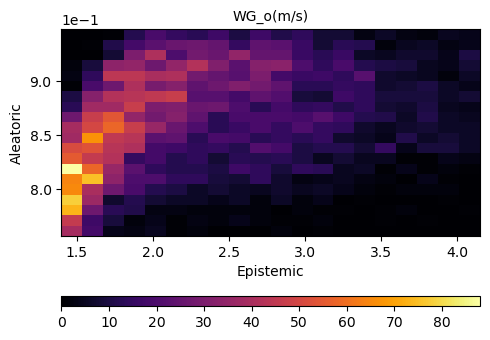

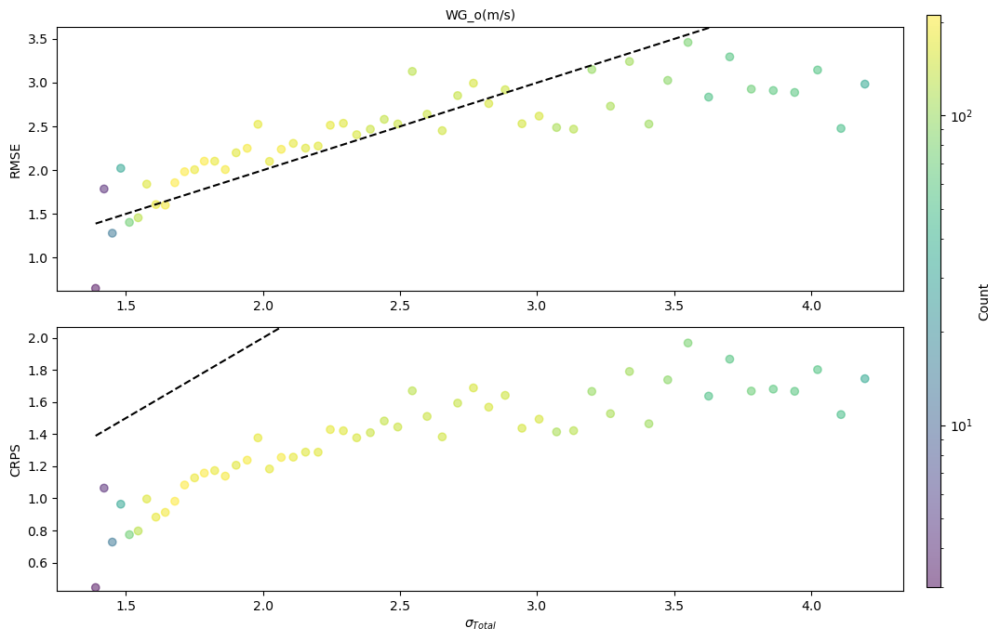

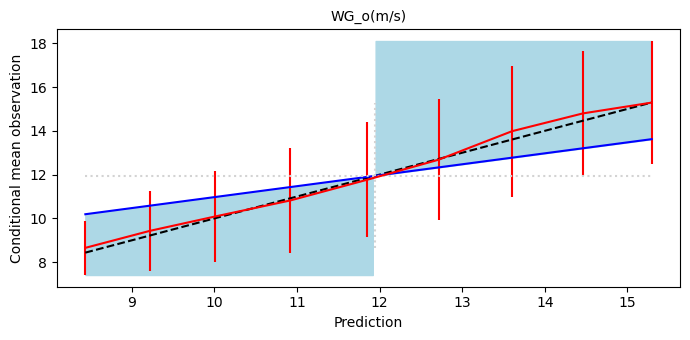

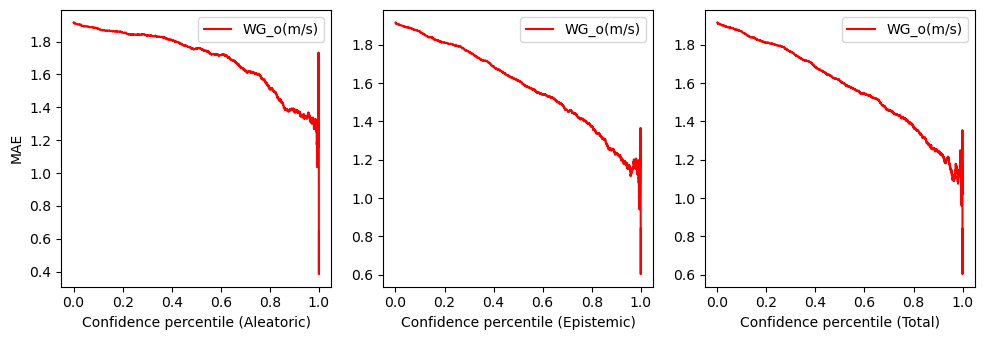

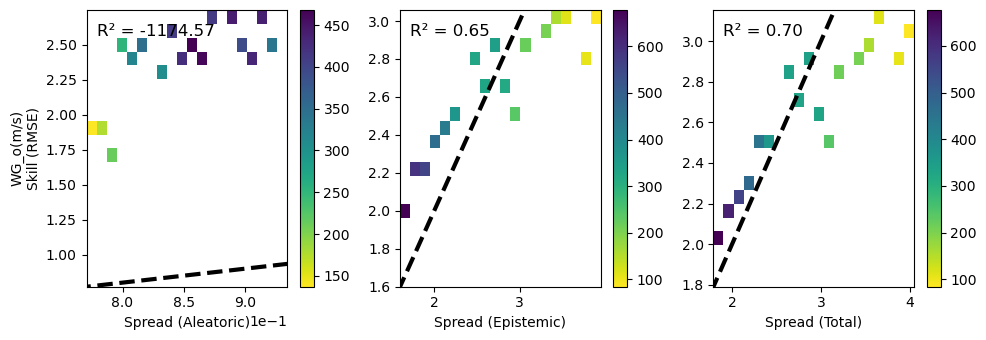

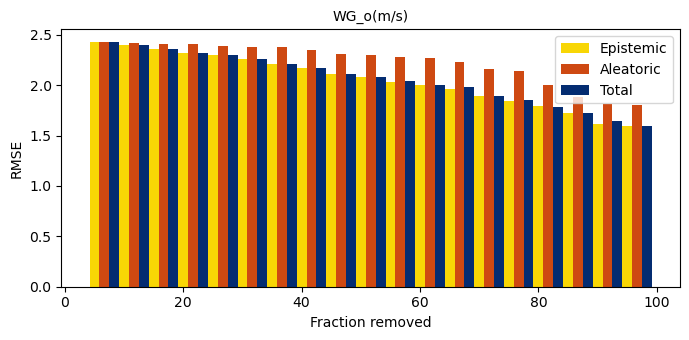

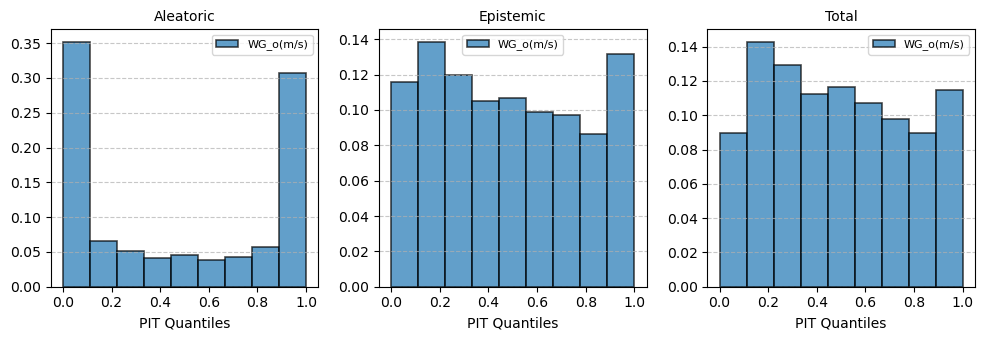

In [112]:
compute_results(
    empty_df,
    output_vars,
    mu,
    aleatoric,
    epistemic,
    legend_cols=output_vars,
    fn=os.path.join(save_loc)
)

In [113]:
final_interpolated_df_new.to_csv('Var_Interpolated_hourwise_2020040912.csv',index=False)

In [114]:
empty_df

,Interpolated_Lat,Interpolated_Lon,Station_ID,Time,YYYY_x,MM_x,DD_x,HH_x,Valid_Time,Join_Array,...,WindDC(cos),WindDC(sin),day_of_year,yday,WG_o(m/s)_pred,WG_o(m/s)_a,WG_o(m/s)_e,WG_o(m/s)_t,WG_o(m/s)_err,tot_uncertainty
0,45.383333,-75.716667,71063099999,2020-04-09 20:00:00,2020,4,9,20,2020040920,71063099999_2020040920,...,0.452435,-0.891798,100,-0.133015,13.224816,0.821376,3.367270,3.466001,2.424816,3.466001
1,45.383333,-75.716667,71063099999,2020-04-09 22:00:00,2020,4,9,22,2020040922,71063099999_2020040922,...,0.409923,-0.912120,100,-0.133015,13.181503,0.875335,3.031920,3.155748,2.881503,3.155748
2,45.383333,-75.716667,71063099999,2020-04-09 23:00:00,2020,4,9,23,2020040923,71063099999_2020040923,...,0.248690,-0.968583,100,-0.133015,12.292352,0.863829,2.439065,2.587516,3.592352,2.587516
3,45.383333,-75.716667,71063099999,2020-04-10 02:00:00,2020,4,10,2,2020041002,71063099999_2020041002,...,0.062791,-0.998027,101,-0.150055,10.128412,0.848673,1.536232,1.755066,1.428412,1.755066
4,45.383333,-75.716667,71063099999,2020-04-10 10:00:00,2020,4,10,10,2020041010,71063099999_2020041010,...,0.932324,-0.361625,101,-0.150055,10.666957,0.885955,1.614235,1.841377,2.966957,1.841377
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7256,43.228680,-76.842610,WOLC,2020-04-11 06:00:00,2020,4,11,6,2020041106,WOLC_2020041106,...,0.806960,-0.590606,102,-0.167052,9.691536,0.775767,1.454541,1.648485,0.291536,1.648485
7257,43.228680,-76.842610,WOLC,2020-04-11 07:00:00,2020,4,11,7,2020041107,WOLC_2020041107,...,0.741976,-0.670427,102,-0.167052,10.369259,0.815492,1.615513,1.809671,2.969259,1.809671
7258,43.228680,-76.842610,WOLC,2020-04-11 08:00:00,2020,4,11,8,2020041108,WOLC_2020041108,...,0.648120,-0.761538,102,-0.167052,10.257268,0.821874,1.564968,1.767654,0.157268,1.767654
7259,43.228680,-76.842610,WOLC,2020-04-11 09:00:00,2020,4,11,9,2020041109,WOLC_2020041109,...,0.669131,-0.743145,102,-0.167052,9.755349,0.815910,1.427265,1.644018,2.355349,1.644018


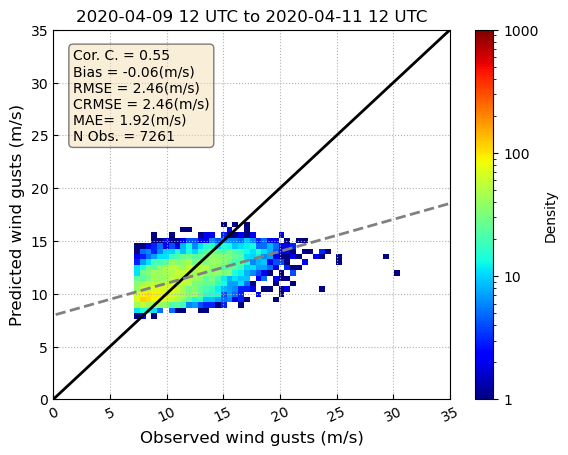

In [115]:
import numpy as np
import math
import pandas as pd
import matplotlib.pyplot as plt
import os
import datetime
import array as ar
from statistics import mean
from scipy import stats
import matplotlib as mpl
import joblib
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
import pickle as pkl


Y_pred_all = empty_df['WG_o(m/s)_pred']
Y_test_all = empty_df['WG_o(m/s)']

Y_pred_all=np.array(Y_pred_all)
Y_test_all=np.array(Y_test_all)
Y_pred_all=Y_pred_all.ravel()
Y_test_all=Y_test_all.ravel()

#calculate error metrics for all Y_pred and Y_test data points together
from sklearn.metrics import mean_squared_error
MSE=mean_squared_error(Y_test_all,Y_pred_all)
MSE=round(MSE,2)
#print("MSE on test data:",MSE)
# Bias= Prediction-Observation
# This is mean bias
BIAS = np.mean(Y_pred_all-Y_test_all)
BIAS=round(BIAS,2)
#print("Bias on test data:",BIAS)
RMSE = mean_squared_error(Y_test_all,Y_pred_all)**0.5
RMSE=round(RMSE,2)
#print("RMSE on test data:",RMSE)
CRMSE = (RMSE**2-BIAS**2)**0.5
CRMSE=round(CRMSE,2)
#print("CRMSE on test data:",CRMSE)
MAE=mean_absolute_error(Y_test_all,Y_pred_all)
MAE=round(MAE,2)

slope, intercept, r_value, p_value, std_err = stats.linregress(Y_test_all,Y_pred_all)
r_value=round(r_value,2)
#Error_heading=['MSE','BIAS','RMSE','CRMSE','MAE','STD_obs','STD_pred','CV_obs','CV_pred','r_value']
Error_heading=['MSE','BIAS','RMSE','CRMSE','MAE','r_value']
#All_error=[MSE,BIAS,RMSE,CRMSE,MAE,STD_test,STD_pred,CV_test,CV_pred,r_value]
All_error=[MSE,BIAS,RMSE,CRMSE,MAE,r_value]
All_error = pd.DataFrame (All_error)
Error_heading = pd.DataFrame (Error_heading)
Error_df=pd.concat([Error_heading,All_error],axis=1)
Error_df.columns=['Error','Value']


fontszt   =12
titlesize =12
fontsz    =16
line_x = np.arange(-1000,10000,10)
c_min  = 1
c_max  = 1000
LWIDTH=2
trp    = 0.6
RTT    = 25.

def Heat_bin_plots(MINXY,MAXXY,INCR,Y_pred_all,Y_test_all,c_min,c_max,
                   xlabel_log,ylabel_log,title_log,yticks_log):
    fig, ax = plt.subplots(1)
    #bins    = (np.arange(MINXY,MAXXY+INCR,step=INCR),np.arange(MINXY,MAXXY+INCR,step=INCR))
    # I put the eps to hide the irreularity in the plot
    eps=0.01
    bins    = (np.arange(MINXY,MAXXY+INCR,step=INCR+eps),np.arange(MINXY,MAXXY+INCR,step=INCR+eps))
    img = plt.hist2d(Y_test_all, Y_pred_all,norm=mpl.colors.LogNorm(), bins=bins, cmin = 1,cmap=plt.cm.jet)
    cbar=plt.colorbar(label="Density", orientation="vertical")
    plt.clim(c_min,c_max)
    cbar.set_ticks([1,10, 100, 1000])
    cbar.set_ticklabels(["1","10", "100", "1000"])
    plt.plot(line_x, line_x,color='black',linewidth=LWIDTH)
    line_y = slope*line_x + intercept
    plt.plot(line_x, line_y,color='gray',linestyle='--',linewidth=LWIDTH)
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    ax.text(0.05,0.95,"Cor. C. = "+str(round(r_value,2))+'\n' "Bias = "+str(BIAS)+'(m/s)'+'\n' "RMSE = "+str(RMSE)+'(m/s)'+'\n' "CRMSE = "+str(CRMSE)+'(m/s)'+'\n' "MAE= "+str(MAE)+'(m/s)'+
            '\n' "N Obs. = "+str(len(Y_test_all)),
            va='top', transform=ax.transAxes, fontsize = 10, color='black',bbox=props)
    # only keep the number of obs in the plot
    #ax.text(0.05,0.95,"Cor. C. = "+str(round(r_value,2))+'\n' "Number of obs. = "+str(len(Y_test_all)), va='top', transform=ax.transAxes, fontsize = 10, color='black')
    
    if title_log==1:
        #FIXME title 
        ax.set_title("2020-04-09 12 UTC to 2020-04-11 12 UTC",fontsize = titlesize)
    if xlabel_log==1:
        ax.set_xlabel("Observed wind gusts (m/s)", fontsize = titlesize)
    if ylabel_log==1:
        ax.set_ylabel("Predicted wind gusts (m/s)",fontsize = titlesize )
    if yticks_log==0:
        ax.set_yticklabels([])
    plt.xticks(rotation=RTT)
    ax.tick_params(axis='both',direction='in')
    plt.grid(visible=None, which='major', axis='both',linestyle=':')
    ax.set_xlim([MINXY,MAXXY])
    ax.set_ylim([MINXY,MAXXY]) 
    
Heat_bin_plots(0,35,0.5,Y_pred_all,Y_test_all,c_min,c_max,1,1,1,1)
plt.savefig('2020040912_interp_preds_vs_obs.png',dpi=300,bbox_inches='tight')

### Percentile distribution

In [116]:
Y_pred_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1640960 entries, 0 to 1640959
Data columns (total 11 columns):
 #   Column       Non-Null Count    Dtype         
---  ------       --------------    -----         
 0   Predictions  1640960 non-null  float32       
 1   Ale(sigma)   1640960 non-null  float32       
 2   Epi(sigma)   1640960 non-null  float32       
 3   Total        1640960 non-null  float32       
 4   Lat          1640960 non-null  float64       
 5   Lon          1640960 non-null  float64       
 6   YYYY         1640960 non-null  int64         
 7   MM           1640960 non-null  int64         
 8   DD           1640960 non-null  int64         
 9   HH           1640960 non-null  int64         
 10  Time         1640960 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float32(4), float64(2), int64(4)
memory usage: 112.7 MB


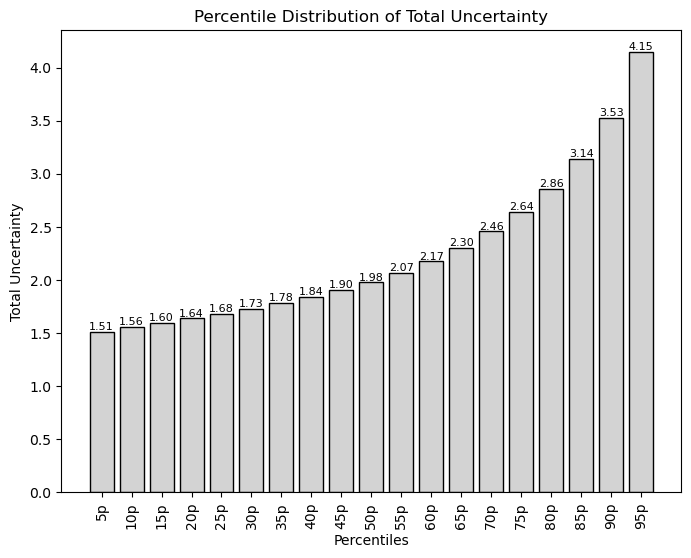

In [117]:
# Define the percentiles you want to compute (excluding 0th and 100th percentiles)
percentiles = np.arange(5, 100, 5)  # 10th, 20th, ..., 90th

# Compute the actual percentile values
percentile_values = np.percentile(Y_pred_df['Total'], percentiles)

# Plot the data
plt.figure(figsize=(8, 6))
bars = plt.bar(
    range(len(percentile_values)), 
    percentile_values, 
    tick_label=[f'{p}p' for p in percentiles],
    edgecolor='black',  # Set the edge color to black
    color='#d3d3d3',    # Set the face color to light grey
)


# Add the exact percentile values on top of each bar
for bar, value in zip(bars, percentile_values):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f'{value:.2f}', ha='center', va='bottom', fontsize=8)

# Rotate x-axis labels by 90 degrees
plt.xticks(rotation=90)
plt.xlabel('Percentiles')
plt.ylabel('Total Uncertainty')
plt.title('Percentile Distribution of Total Uncertainty')

plt.savefig('2020040912_total_uq_p_dist.png',dpi=300,bbox_inches='tight')

In [118]:
Y_pred_df['Total'].min()

1.2776823

In [119]:
Y_pred_df['Total'].max()

21.09996

In [120]:
Y_pred_df['Total'].quantile(0.5)

1.9767104387283325

In [121]:
df_sorted = Y_pred_df.sort_values(by='Total', ascending=False)

In [122]:
df_sorted

,Predictions,Ale(sigma),Epi(sigma),Total,Lat,Lon,YYYY,MM,DD,HH,Time
1252350,18.317404,1.028196,21.074894,21.099960,42.10,-74.10,2020,4,11,1,2020-04-11 01:00:00
1218861,18.250830,1.034082,20.161396,20.187899,42.10,-74.10,2020,4,11,0,2020-04-11 00:00:00
1301647,17.074778,1.022138,17.047941,17.078556,44.98,-70.31,2020,4,11,2,2020-04-11 02:00:00
1196775,18.037470,1.036352,16.683504,16.715662,44.17,-71.08,2020,4,10,23,2020-04-10 23:00:00
1335136,16.807615,1.011339,16.043579,16.075422,44.98,-70.31,2020,4,11,3,2020-04-11 03:00:00
...,...,...,...,...,...,...,...,...,...,...,...
633505,7.067143,0.494908,1.186432,1.285517,45.33,-70.72,2020,4,10,6,2020-04-10 06:00:00
266703,7.629126,0.550801,1.160445,1.284529,45.84,-74.26,2020,4,9,19,2020-04-09 19:00:00
633871,7.237719,0.531593,1.168544,1.283778,45.41,-70.71,2020,4,10,6,2020-04-10 06:00:00
267063,7.447159,0.535149,1.166487,1.283385,45.93,-74.56,2020,4,9,19,2020-04-09 19:00:00


### Plot total UQ that are greater than 95 percentile

In [123]:
short_df= Y_pred_df[Y_pred_df['Total']>4.15]

In [124]:
short_df

,Predictions,Ale(sigma),Epi(sigma),Total,Lat,Lon,YYYY,MM,DD,HH,Time
11004,12.821413,0.995583,5.218013,5.312141,41.75,-76.88,2020,4,9,12,2020-04-09 12:00:00
14160,11.707113,0.984512,4.057795,4.175520,42.30,-74.67,2020,4,9,12,2020-04-09 12:00:00
15204,13.436841,0.990817,4.903535,5.002637,42.59,-77.29,2020,4,9,12,2020-04-09 12:00:00
15388,13.210605,0.969070,4.557993,4.659871,42.62,-77.24,2020,4,9,12,2020-04-09 12:00:00
50418,13.136124,1.026800,4.274789,4.396378,42.79,-73.46,2020,4,9,13,2020-04-09 13:00:00
...,...,...,...,...,...,...,...,...,...,...,...
1632495,11.961543,0.965663,4.829030,4.924635,44.25,-71.22,2020,4,11,12,2020-04-11 12:00:00
1632496,12.290281,0.972605,5.244044,5.333476,44.25,-71.17,2020,4,11,12,2020-04-11 12:00:00
1632677,10.856618,0.921502,4.318846,4.416061,44.29,-71.26,2020,4,11,12,2020-04-11 12:00:00
1632679,11.350532,0.943087,4.313388,4.415284,44.28,-71.16,2020,4,11,12,2020-04-11 12:00:00


In [125]:
short_df['Total'].quantile(0.005)

4.153896350860595

In [126]:
short_df['Total'].quantile(0.995)

7.799702386856082

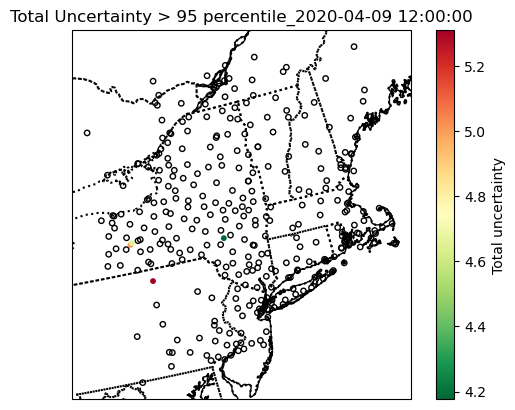

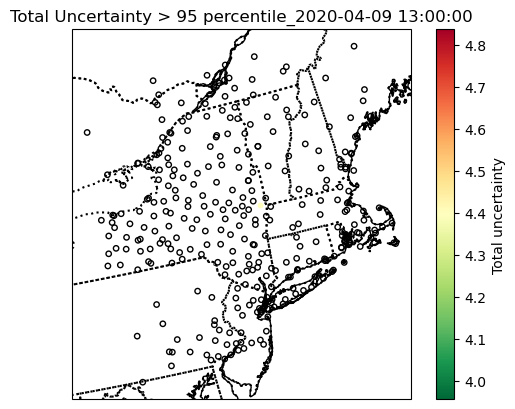

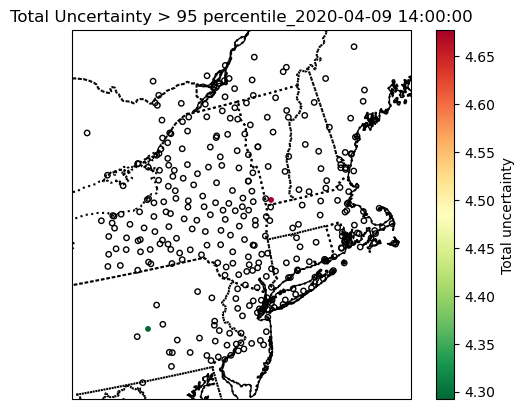

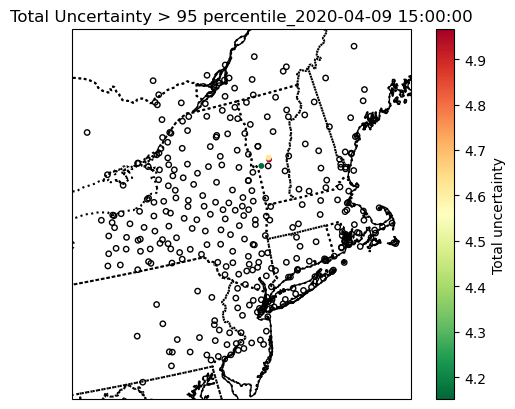

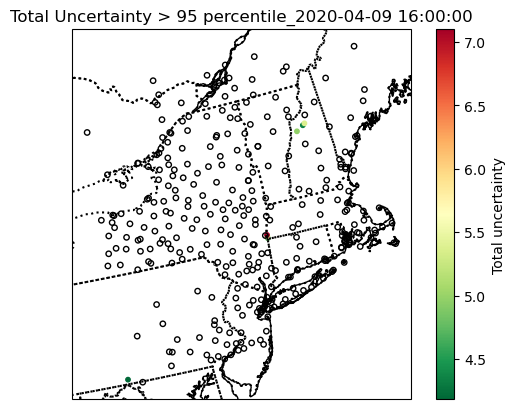

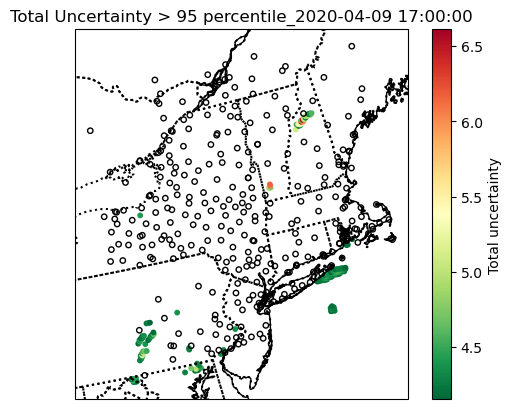

In [ ]:
save_path='/glade/u/home/ijahan/notebook_evidential_IJ/Gridded_preds/Spatial_plots/2020_04_09_12UTC/Above_95p_tot_UQ/'
# Loop over each hour until the end time is reached
for day in pd.date_range(start=short_df['Time'].iloc[0], end=end_time, freq='h'):  
    # Filter Y_pred_df to include only data from the current hour
    day_data = short_df[(short_df['Time'].dt.month == day.month) &  (short_df['Time'].dt.day == day.day) & (short_df['Time'].dt.hour == day.hour) ]
    # Plotting the data
    ax = plt.subplot(1, 1, 1, projection=ccrs.LambertConformal()) # I want the resultiong map to have Lambert Corformal Conic projection 
    # Create a custom colormap
    cmap = plt.cm.RdYlGn_r
    # cmap_combined = colors.ListedColormap(['blue']+list(cmap(np.linspace(0, 1, 256))) + ['purple'])
    # val_min = 4
    # val_max = 10
    # norm = colors.Normalize(vmin=val_min, vmax=val_max)
    # Add coastlines
    ax.coastlines(resolution='10m')
    
    ax.add_feature(cfeature.STATES, linestyle=':', edgecolor='black',linewidth=1.5)
    #ax.add_feature(cfeature.OCEAN, zorder=12)  #zorder > 10
    
    # Since my data is deined on  lat-lon values,I need to use PlateCarree in the transform argument
    
    scatter=plt.scatter(day_data['Lon'], day_data['Lat'], c=day_data['Total'], cmap=cmap,transform=ccrs.PlateCarree(), s=10) 
    plt.scatter(stations["Lon"], stations["Lat"], s=15, edgecolor='black', facecolors='none', transform=ccrs.PlateCarree())
    #colorbar = plt.colorbar(scatter, label='Epistemic')
    colorbar = plt.colorbar(scatter, label='Total uncertainty')

    # # Add colorbar
    # plt.colorbar(scatter, ax=ax, orientation='vertical', label='Predicted gusts(m/s)',
    #              boundaries=boundaries, ticks=boundaries, format='%g')  # Add a label for the colorbar
    
    # Add title and labels
    plt.title('Total Uncertainty > 95 percentile_'+ str(day))
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.savefig(save_path+'Above_95p_total_'+str(day)+'.png', dpi=600, bbox_inches= 'tight')
    plt.show()